In [1]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 17.6 MB/s eta 0:00:00


In [9]:
import os
import cv2
import glob
import yaml
import random
import pathlib
import numpy as np
import pandas as pd
from PIL import Image
import seaborn as sns
from tqdm import tqdm
from ultralytics import YOLO
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from tqdm.notebook import trange, tqdm
from IPython.display import Image, Video
from IPython.display import Image, display
from sklearn.metrics import precision_score, recall_score
!wandb disabled
import warnings
warnings.filterwarnings('ignore')

W&B disabled.


In [ ]:
!unzip VehiclesDetectionDataset.zip

In [5]:
train_path = '/content/train/images'
val_path = '/content/valid/images'
test_path = '/content/test/images'

yaml_content = f"""
test: {test_path}
train: {train_path}
val: {val_path}

nc: 5  # Number of classes
names: ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']
"""
output_path = 'data.yaml'
with open(output_path, 'w') as file:
    file.write(yaml_content)
color_code = "\033[38;2;163;196;243m"
reset_code = "\033[0m"
print(f"{color_code}YAML file has been saved to {output_path}{reset_code}")

YAML file has been saved to data.yaml


In [6]:
output_path = 'data.yaml'
with open(output_path, 'r') as file:
    data = yaml.safe_load(file)
class_names = data['names']
print(f"{color_code}Class Names:{reset_code} {class_names}")

Class Names: ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']


In [13]:
import os
import random
from PIL import Image
images_folder = '/content/train/images'
image_files = [f for f in os.listdir(images_folder) if f.endswith(('.jpg', '.png', '.jpeg'))]
random_image = random.choice(image_files)
random_image_path = os.path.join(images_folder, random_image)
image = Image.open(random_image_path)
image_size = image.size
image_mode = image.mode
num_channels = image.layers if hasattr(image, 'layers') else len(image.getbands())
print(f"Random Image: {random_image}")
print(f"Image Size: {image_size}")
print(f"Image Mode (Channels): {image_mode}")
print(f"Number of Channels: {num_channels}")

Random Image: 00aaf0a0a9ee7e71_jpg.rf.KBCzX2HtZviBuQY9JDTQ.jpg
Image Size: (416, 416)
Image Mode (Channels): RGB
Number of Channels: 3


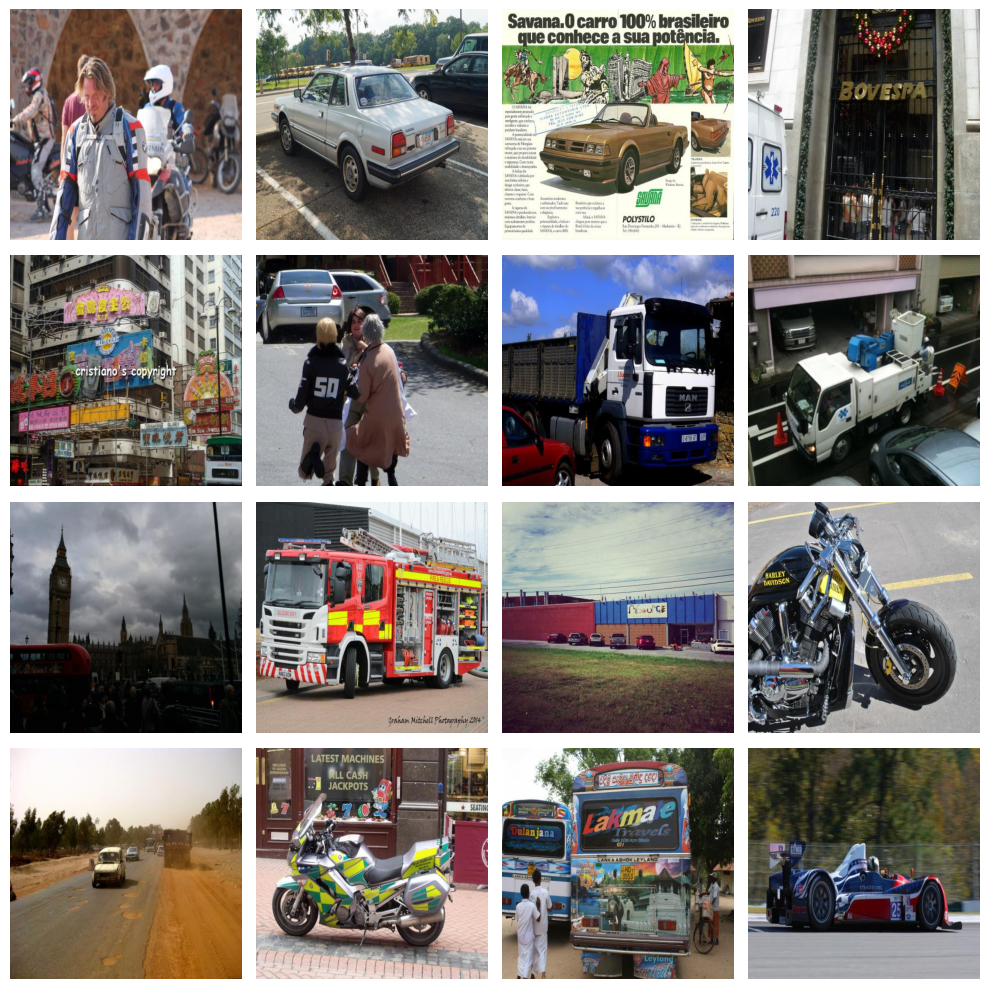

In [14]:
image_files = [f for f in os.listdir(train_path) if f.endswith('.jpg')]
selected_images = random.sample(image_files, 16)
fig, axes = plt.subplots(4, 4, figsize=(10, 10))
for i, ax in enumerate(axes.flat):
    img_path = os.path.join(train_path, selected_images[i])
    img = mpimg.imread(img_path)
    ax.imshow(img)
    ax.axis('off')
plt.tight_layout()
plt.show()


image 1/1 /content/train/images/4efd242e1c4b204c_jpg.rf.c80bacb52c25ce734031d8e8c4a1feb2.jpg: 416x416 2 cars, 2 trucks, 6.3ms
Speed: 4.7ms preprocess, 6.3ms inference, 372.4ms postprocess per image at shape (1, 3, 416, 416)


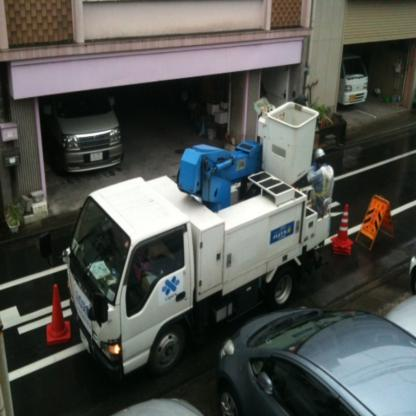

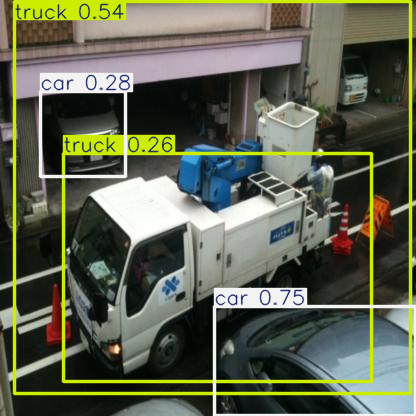


image 1/1 /content/train/images/c9ddb43cf0449556_jpg.rf.9e8dc04872a4da15c6f7c88e87a5c5b0.jpg: 416x416 2 trucks, 8.6ms
Speed: 1.1ms preprocess, 8.6ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)


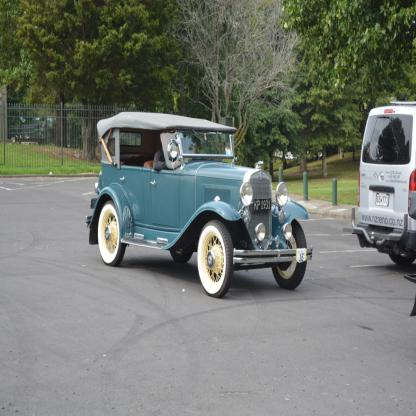

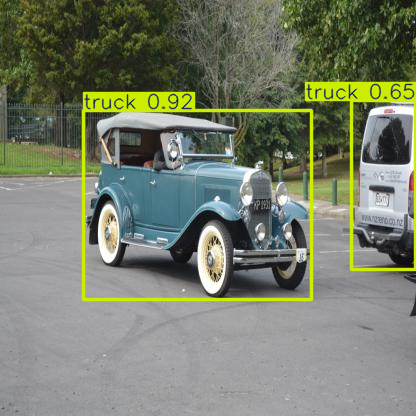


image 1/1 /content/train/images/878749c0431be08b_jpg.rf.AxEHzN8hJMJsiy8E1Y86.jpg: 416x416 1 person, 1 motorcycle, 8.0ms
Speed: 1.2ms preprocess, 8.0ms inference, 2.1ms postprocess per image at shape (1, 3, 416, 416)


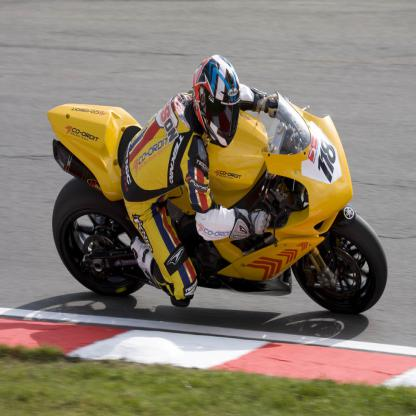

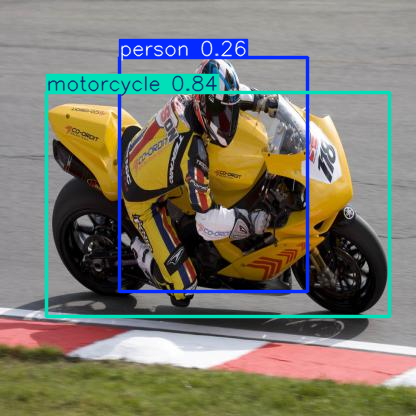


image 1/1 /content/train/images/b9e1dcfd07291353_jpg.rf.6901689869f1beca039961a2eb7aef53.jpg: 416x416 1 person, 1 motorcycle, 9.6ms
Speed: 1.4ms preprocess, 9.6ms inference, 2.9ms postprocess per image at shape (1, 3, 416, 416)


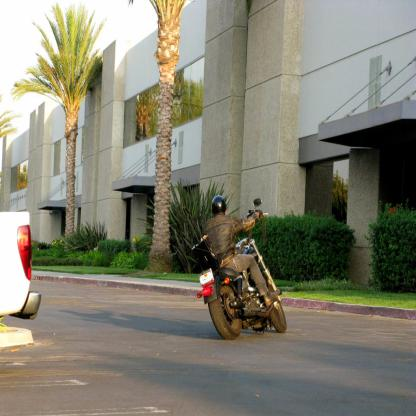

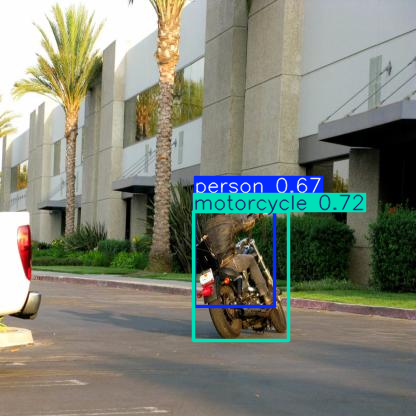


image 1/1 /content/train/images/39fac0e910b58065_jpg.rf.kxmJGQuFtjZOQOvx65Nw.jpg: 416x416 2 cars, 1 truck, 9.7ms
Speed: 1.0ms preprocess, 9.7ms inference, 3.5ms postprocess per image at shape (1, 3, 416, 416)


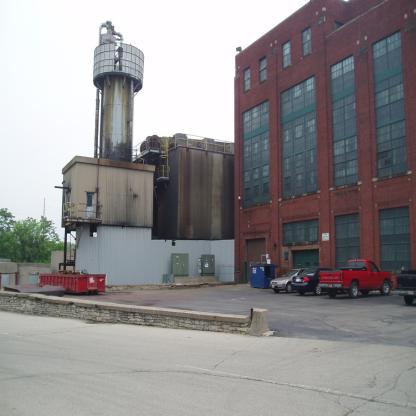

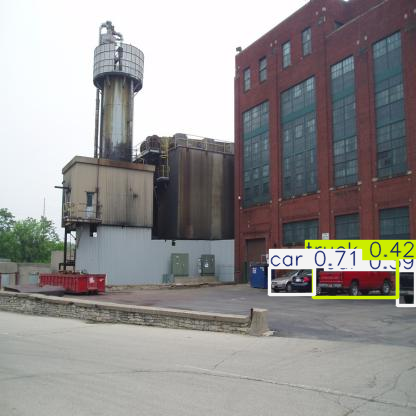


image 1/1 /content/train/images/045f8f2e4c2e3077_jpg.rf.UTYIHRlCuTNPmBhGUQ8A.jpg: 416x416 3 persons, 1 car, 1 truck, 7.7ms
Speed: 1.1ms preprocess, 7.7ms inference, 8.5ms postprocess per image at shape (1, 3, 416, 416)


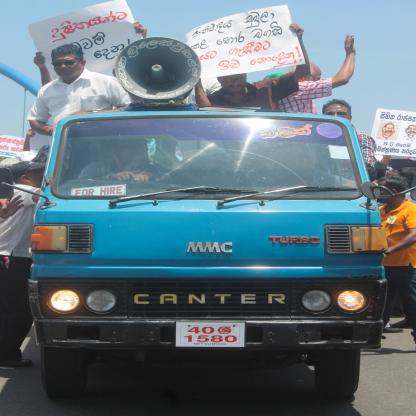

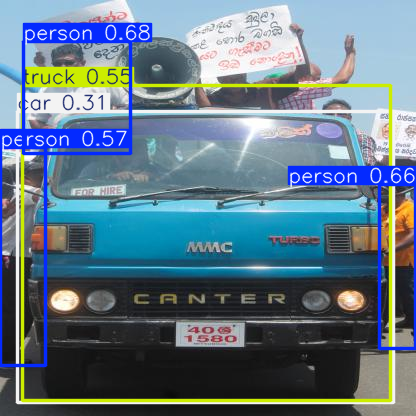


image 1/1 /content/train/images/aecd7416f432a683_jpg.rf.TBc607mPUq0PybaJP48d.jpg: 416x416 1 truck, 11.4ms
Speed: 1.1ms preprocess, 11.4ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 416)


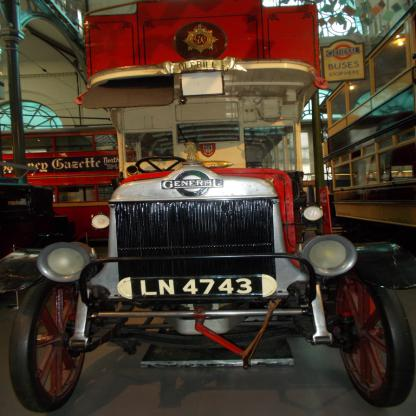

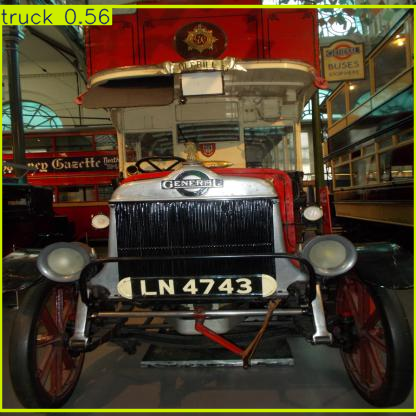


image 1/1 /content/train/images/a86e99068ec8dade_jpg.rf.zBz4TFkOzkpchoAdAlP3.jpg: 416x416 1 person, 1 car, 9.0ms
Speed: 1.1ms preprocess, 9.0ms inference, 5.8ms postprocess per image at shape (1, 3, 416, 416)


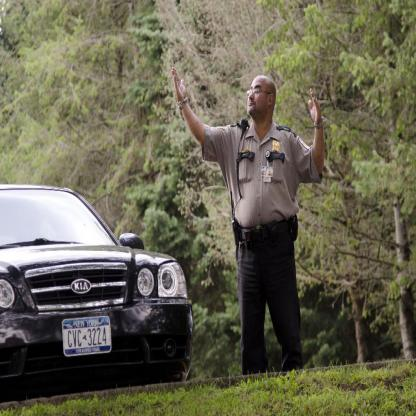

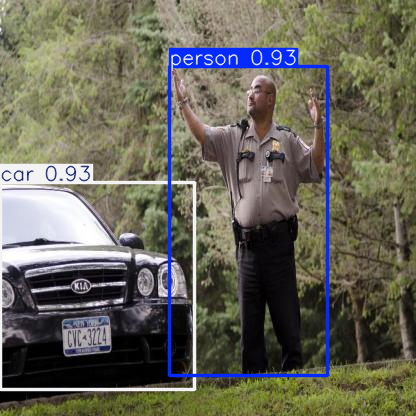


image 1/1 /content/train/images/63ea081863347bfe_jpg.rf.uXQgyuoKnIs6bxf1VfOa.jpg: 416x416 3 persons, 2 motorcycles, 11.4ms
Speed: 1.2ms preprocess, 11.4ms inference, 5.1ms postprocess per image at shape (1, 3, 416, 416)


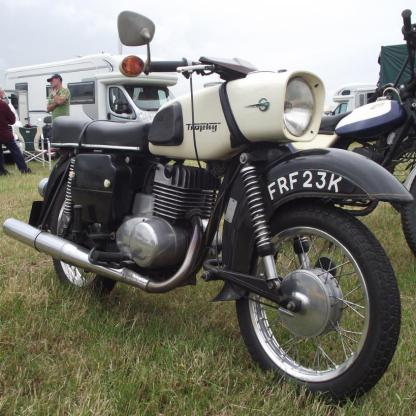

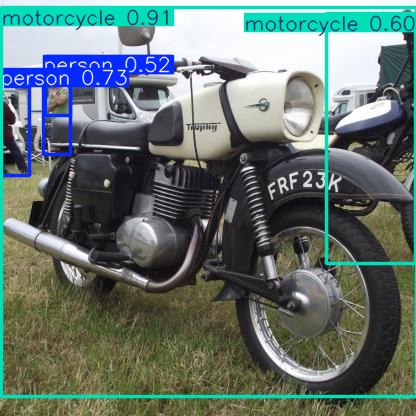


image 1/1 /content/train/images/3adea569e0432f6a_jpg.rf.f5ec9f3b918929fd28610ece31f70228.jpg: 416x416 1 person, 3 cars, 2 traffic lights, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 4.5ms postprocess per image at shape (1, 3, 416, 416)


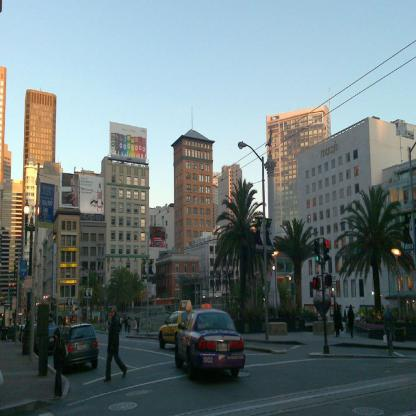

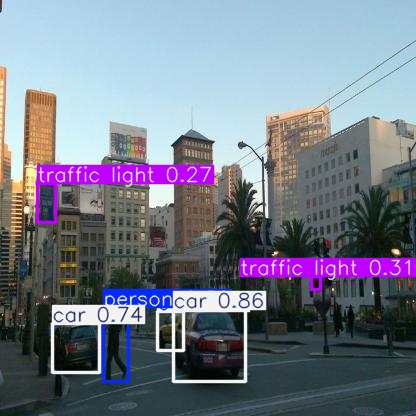


image 1/1 /content/train/images/469b1bb2ece31056_jpg.rf.5gdHdsuj5Lq4ePSjTrAI.jpg: 416x416 1 person, 1 car, 10.9ms
Speed: 2.0ms preprocess, 10.9ms inference, 2.8ms postprocess per image at shape (1, 3, 416, 416)


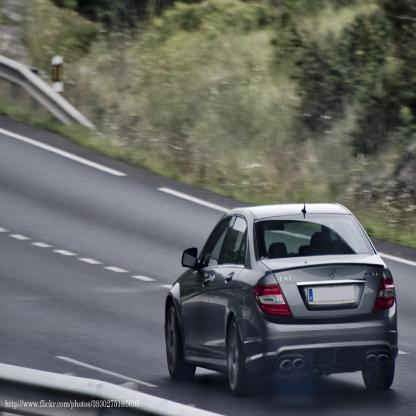

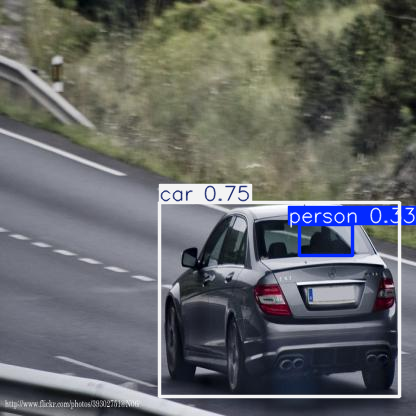


image 1/1 /content/train/images/eee9fc95c2437751_jpg.rf.1ddf62c320693d33173ca88eaba655db.jpg: 416x416 1 bus, 10.0ms
Speed: 1.3ms preprocess, 10.0ms inference, 2.3ms postprocess per image at shape (1, 3, 416, 416)


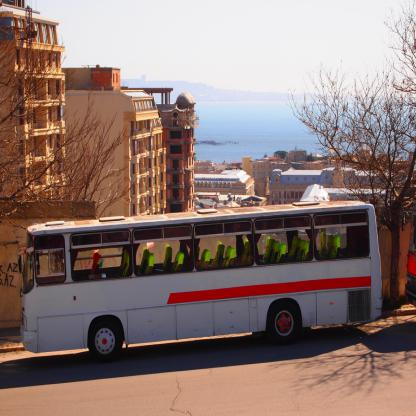

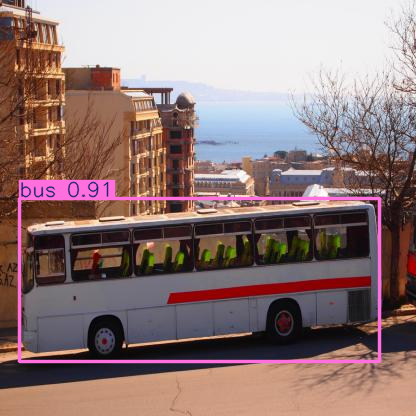


image 1/1 /content/train/images/c6f32b8a12b9a44a_jpg.rf.HA5yUO5uJFelKZEe6UpT.jpg: 416x416 2 persons, 5 motorcycles, 8.5ms
Speed: 1.3ms preprocess, 8.5ms inference, 5.9ms postprocess per image at shape (1, 3, 416, 416)


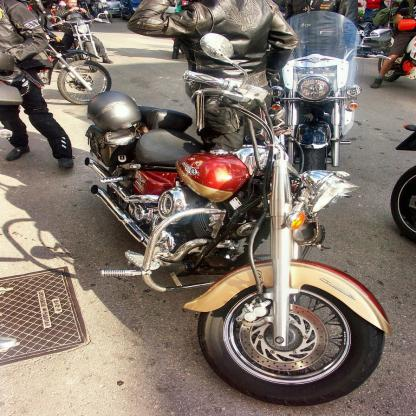

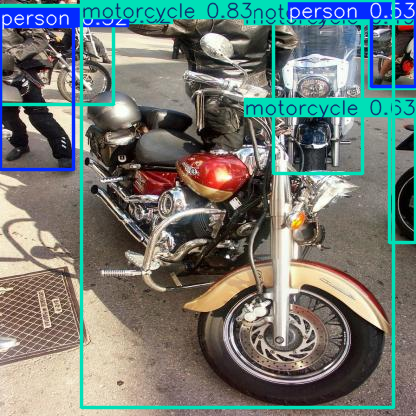


image 1/1 /content/train/images/5b0f57b9bad38bc2_jpg.rf.7a9fc6b8d1b6dab10d7244fb653a0fde.jpg: 416x416 1 bus, 1 truck, 8.7ms
Speed: 1.1ms preprocess, 8.7ms inference, 2.6ms postprocess per image at shape (1, 3, 416, 416)


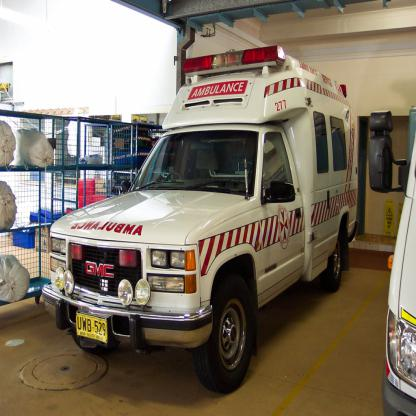

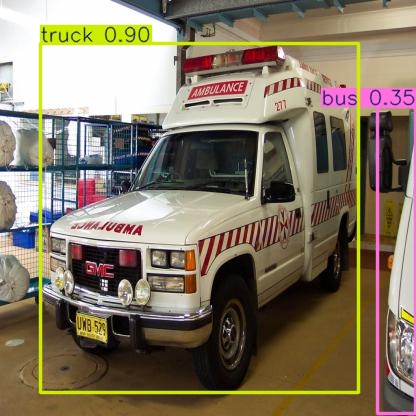


image 1/1 /content/train/images/2d94e4aa09c1c7de_jpg.rf.PqpF5J0wmYBef380GjYT.jpg: 416x416 2 persons, 1 bicycle, 1 truck, 8.7ms
Speed: 1.2ms preprocess, 8.7ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)


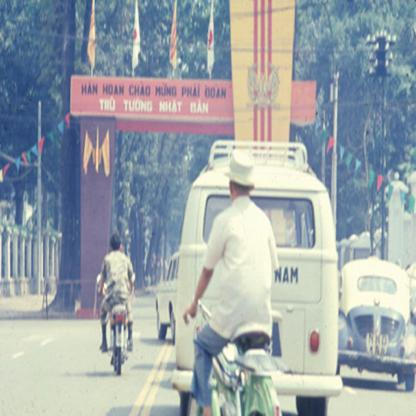

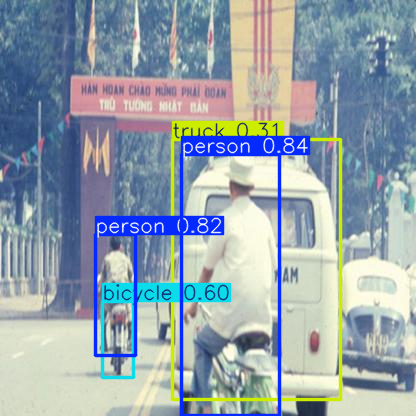


image 1/1 /content/train/images/dc0dbdc656725dc2_jpg.rf.YjuyJ7f1Nm3h5yQeDkA9.jpg: 416x416 1 car, 8.0ms
Speed: 1.1ms preprocess, 8.0ms inference, 2.5ms postprocess per image at shape (1, 3, 416, 416)


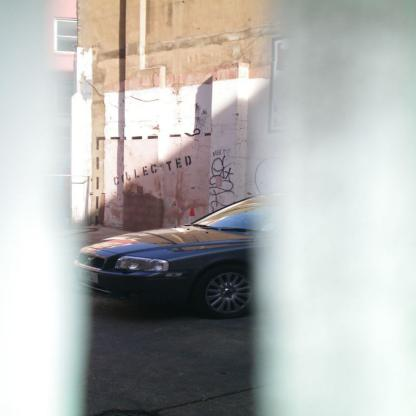

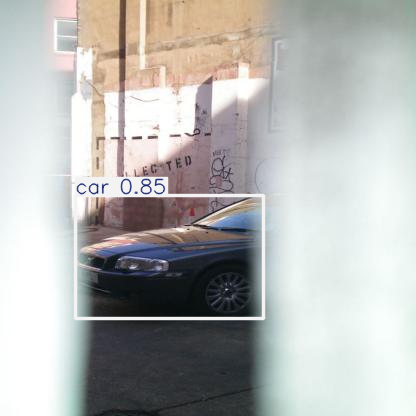


image 1/1 /content/train/images/6f90ee12f14ee50a_jpg.rf.850532392ee43b612c8ac775907038b3.jpg: 416x416 8 persons, 9.4ms
Speed: 1.1ms preprocess, 9.4ms inference, 5.3ms postprocess per image at shape (1, 3, 416, 416)


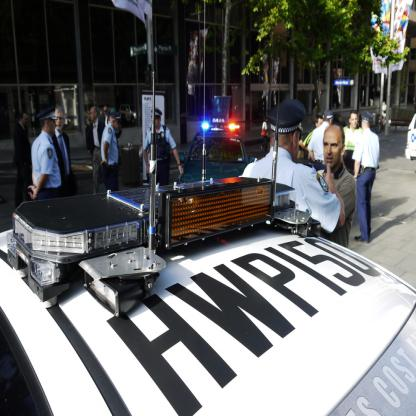

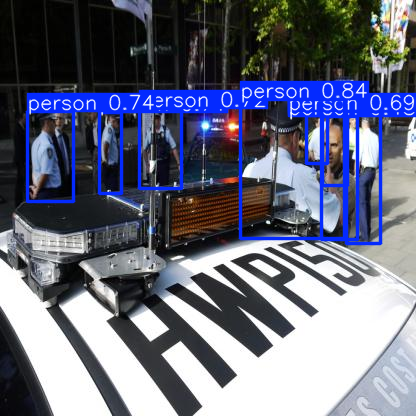


image 1/1 /content/train/images/ed24483d1c6d977f_jpg.rf.P7ViJg97JbjAi0F4n1R3.jpg: 416x416 3 cars, 1 truck, 8.8ms
Speed: 1.1ms preprocess, 8.8ms inference, 3.5ms postprocess per image at shape (1, 3, 416, 416)


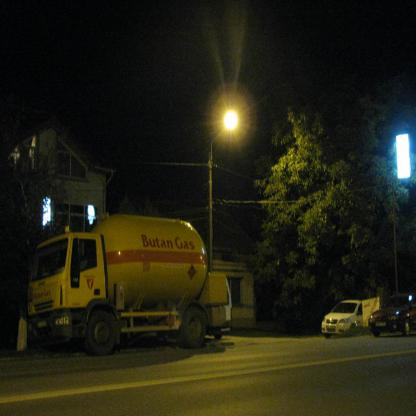

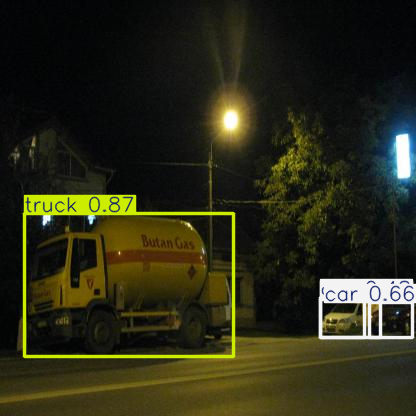


image 1/1 /content/train/images/00aaf0a0a9ee7e71_jpg.rf.808b1e59067887493dffad63561c2a9d.jpg: 416x416 1 truck, 7.7ms
Speed: 1.0ms preprocess, 7.7ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 416)


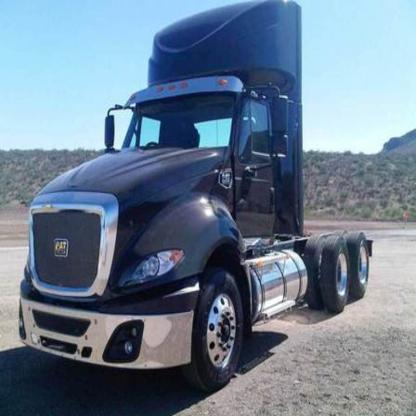

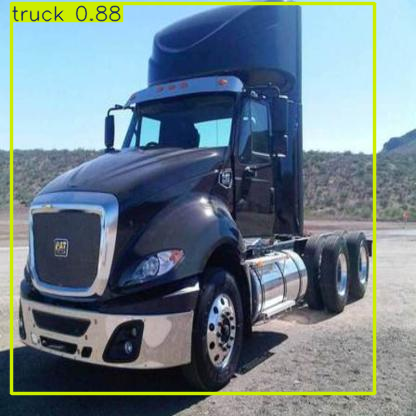


image 1/1 /content/train/images/2c22bcb9295eacdf_jpg.rf.Ffq2LsNEib2qyrQegkD5.jpg: 416x416 1 car, 2 trucks, 9.3ms
Speed: 1.0ms preprocess, 9.3ms inference, 6.4ms postprocess per image at shape (1, 3, 416, 416)


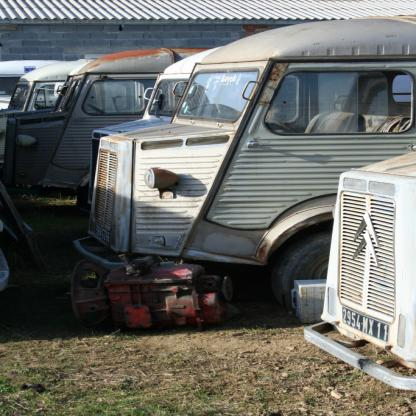

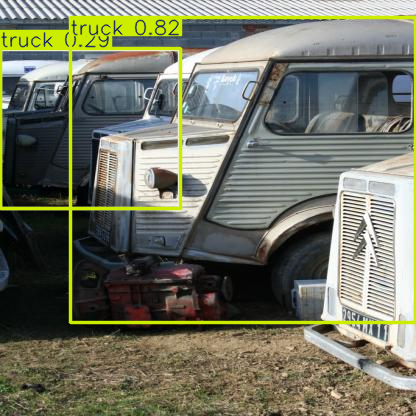

In [15]:
images_folder = '/content/train/images'
image_files = [f for f in os.listdir(images_folder) if f.endswith(('.jpg', '.png', '.jpeg'))]
random_images = random.sample(image_files, 20)
model = YOLO("yolov8n.pt")
for image_file in random_images:
    image_path = os.path.join(images_folder, image_file)
    result_predict = model.predict(source=image_path, imgsz=(416))
    original_image = Image.open(image_path)
    display(original_image)
    for result in result_predict:
        plot = result.plot()
        plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
        display(Image.fromarray(plot))


image 1/1 /content/train/images/bfa31c9efb82129a_jpg.rf.171a6c5bd6b5337fa8d03d2a4d626144.jpg: 416x416 3 persons, 3 bicycles, 2 motorcycles, 9.6ms
Speed: 1.0ms preprocess, 9.6ms inference, 5.8ms postprocess per image at shape (1, 3, 416, 416)


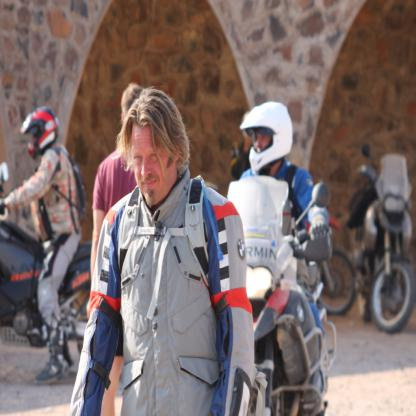

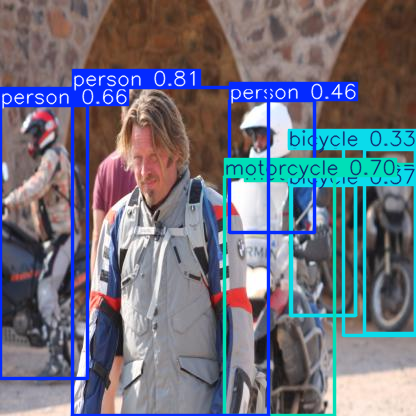


image 1/1 /content/train/images/a6584f0e0dcbf71c_jpg.rf.0cf0d194f8c5d5f0fa50f9f12c7723c9.jpg: 416x416 3 persons, 1 car, 1 bus, 12.4ms
Speed: 1.0ms preprocess, 12.4ms inference, 4.2ms postprocess per image at shape (1, 3, 416, 416)


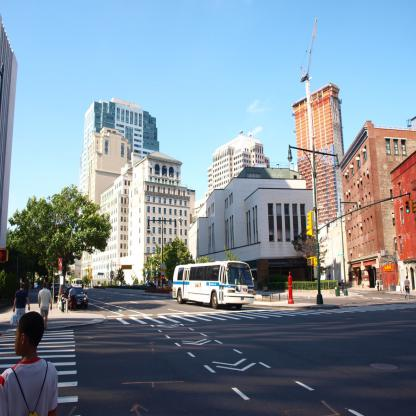

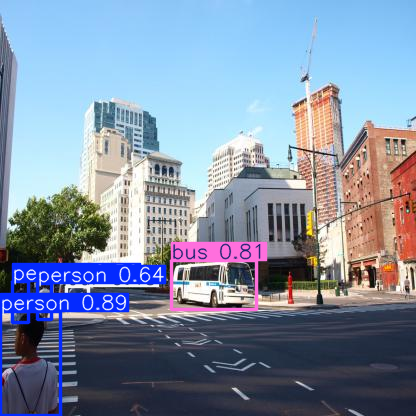


image 1/1 /content/train/images/559a81baaab7e2df_jpg.rf.8c7b6510f942935082fbf3f2fe52aa15.jpg: 416x416 12 persons, 1 motorcycle, 1 umbrella, 1 suitcase, 13.0ms
Speed: 1.2ms preprocess, 13.0ms inference, 9.3ms postprocess per image at shape (1, 3, 416, 416)


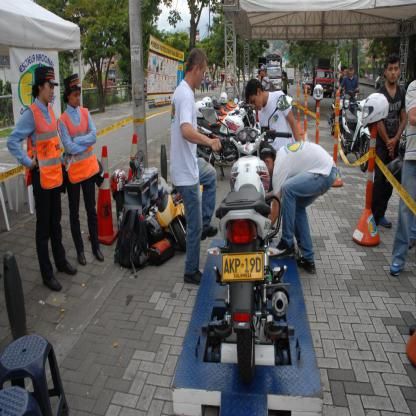

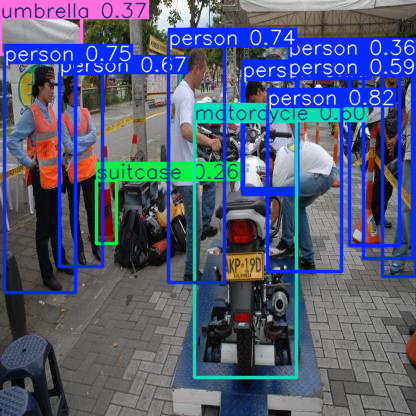


image 1/1 /content/train/images/0dddb5e2bc416a16_jpg.rf.5251d5e30ac2b063ecc31284d512c8c1.jpg: 416x416 18 cars, 2 trucks, 4 stop signs, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 3.5ms postprocess per image at shape (1, 3, 416, 416)


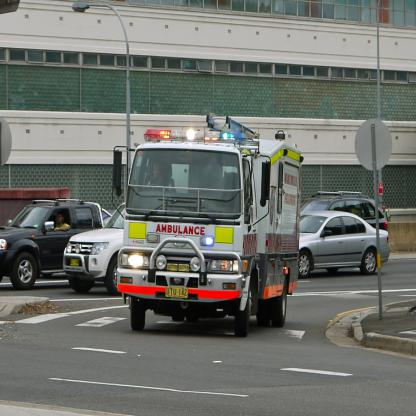

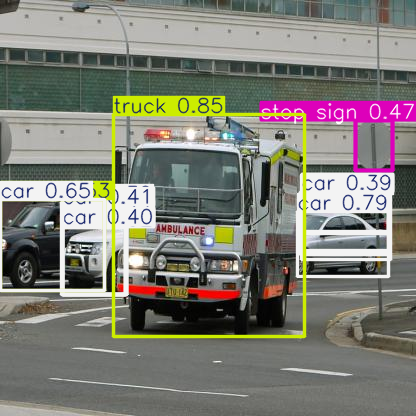


image 1/1 /content/train/images/8ee800b43a4797d5_jpg.rf.qosID3oZl92FOKr1pT0f.jpg: 416x416 (no detections), 8.0ms
Speed: 1.3ms preprocess, 8.0ms inference, 2.9ms postprocess per image at shape (1, 3, 416, 416)


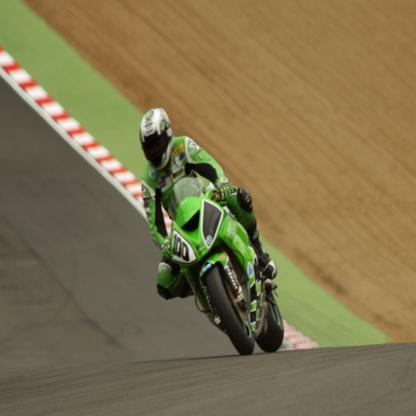

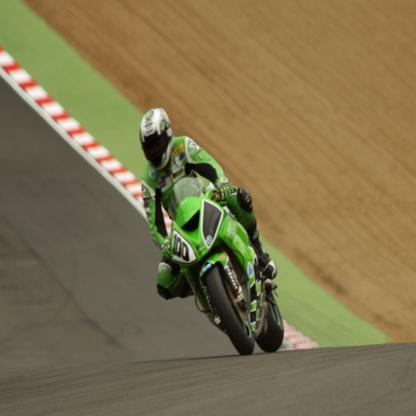


image 1/1 /content/train/images/43dcff50b018f61c_jpg.rf.9eea21aacb74bbce06afad5ecdee43b4.jpg: 416x416 2 persons, 1 car, 10.5ms
Speed: 1.0ms preprocess, 10.5ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 416)


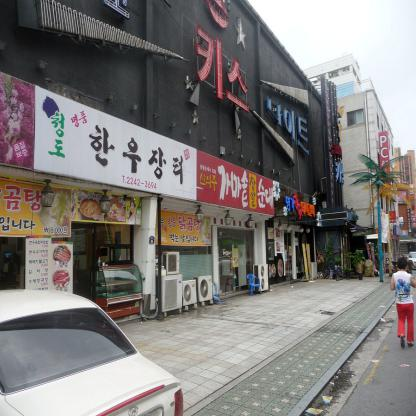

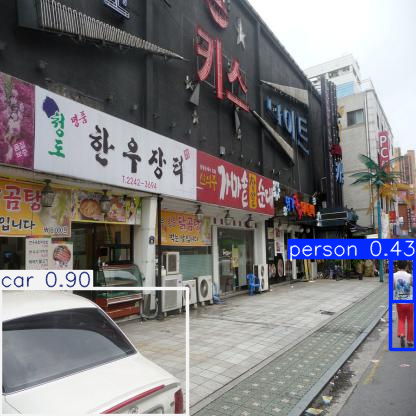


image 1/1 /content/train/images/44e913fc3c81999f_jpg.rf.VLFM5Y5bUgIEYUU7VFJa.jpg: 416x416 1 clock, 13.2ms
Speed: 1.2ms preprocess, 13.2ms inference, 2.6ms postprocess per image at shape (1, 3, 416, 416)


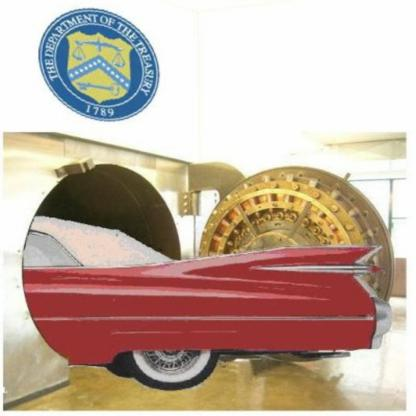

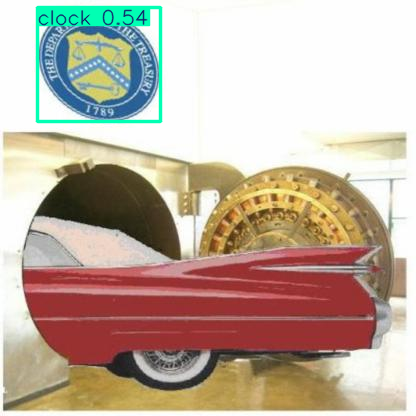


image 1/1 /content/train/images/8d96556cdec8743f_jpg.rf.b3e36f3f36339be1fa3fd5d297742692.jpg: 416x416 1 car, 11.7ms
Speed: 1.2ms preprocess, 11.7ms inference, 2.1ms postprocess per image at shape (1, 3, 416, 416)


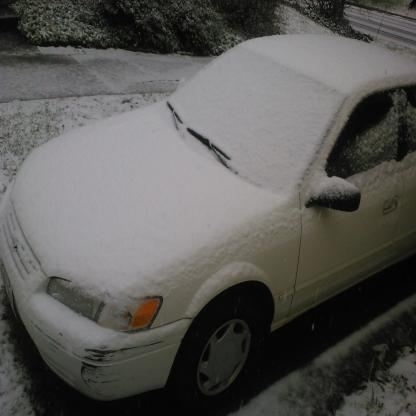

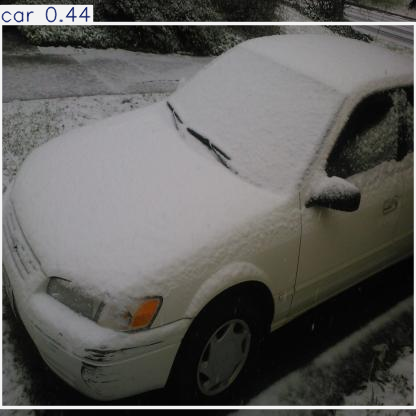


image 1/1 /content/train/images/e0911bf7f6fa1c50_jpg.rf.bd80218310032b8781fd4753c1073ce8.jpg: 416x416 10 persons, 1 car, 1 truck, 1 backpack, 11.2ms
Speed: 1.2ms preprocess, 11.2ms inference, 8.8ms postprocess per image at shape (1, 3, 416, 416)


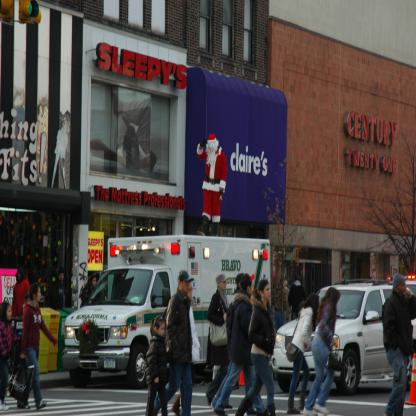

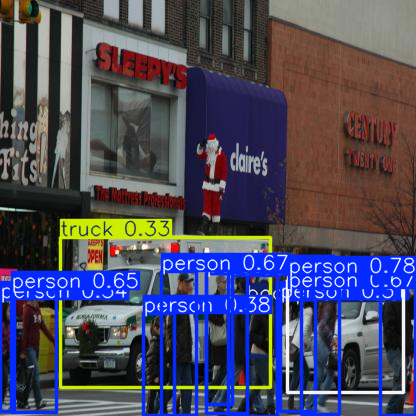


image 1/1 /content/train/images/4039b64d9f2b5291_jpg.rf.567152c08edc2a1d7f8118551d3e2b74.jpg: 416x416 1 motorcycle, 11.7ms
Speed: 1.2ms preprocess, 11.7ms inference, 2.1ms postprocess per image at shape (1, 3, 416, 416)


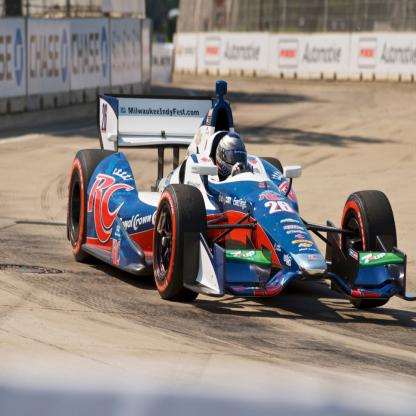

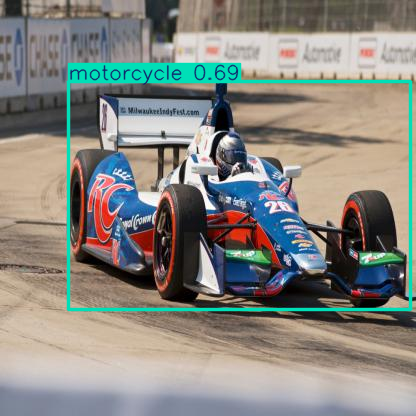


image 1/1 /content/train/images/a3a9d9452578defa_jpg.rf.dIRPP7YKEfOl6ltUhnoH.jpg: 416x416 4 persons, 1 bus, 1 clock, 10.7ms
Speed: 1.1ms preprocess, 10.7ms inference, 4.9ms postprocess per image at shape (1, 3, 416, 416)


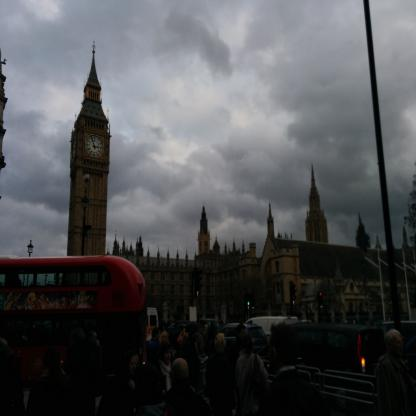

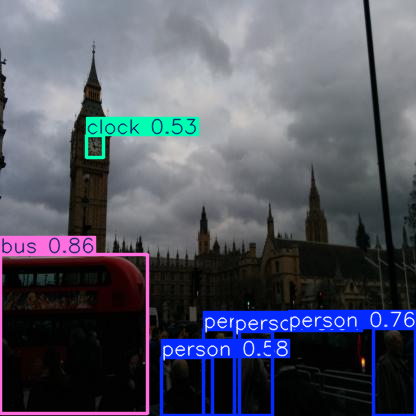


image 1/1 /content/train/images/a7d33981079f545f_jpg.rf.9bd2e179a81576c858ed8eddfb1958ae.jpg: 416x416 1 bus, 1 truck, 9.8ms
Speed: 1.2ms preprocess, 9.8ms inference, 2.6ms postprocess per image at shape (1, 3, 416, 416)


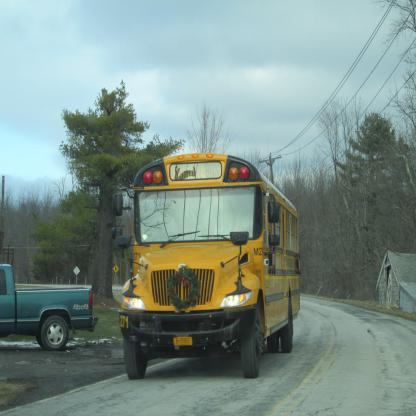

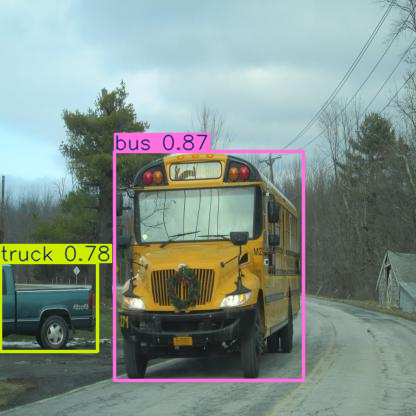


image 1/1 /content/train/images/d56b0614c384299d_jpg.rf.P7cc3Z47Up3NkPpWqmst.jpg: 416x416 1 person, 1 car, 1 truck, 11.2ms
Speed: 1.2ms preprocess, 11.2ms inference, 3.5ms postprocess per image at shape (1, 3, 416, 416)


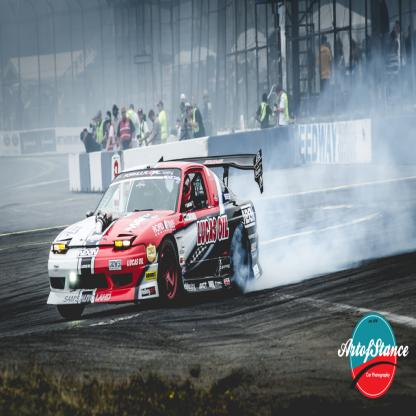

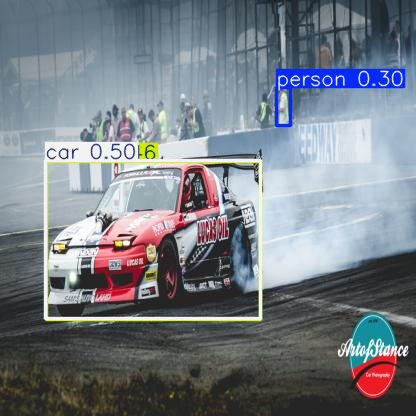


image 1/1 /content/train/images/33982df55de352d9_jpg.rf.1pPpUTs1hrzFsrWygDzG.jpg: 416x416 3 cars, 2 trucks, 8.5ms
Speed: 1.1ms preprocess, 8.5ms inference, 6.0ms postprocess per image at shape (1, 3, 416, 416)


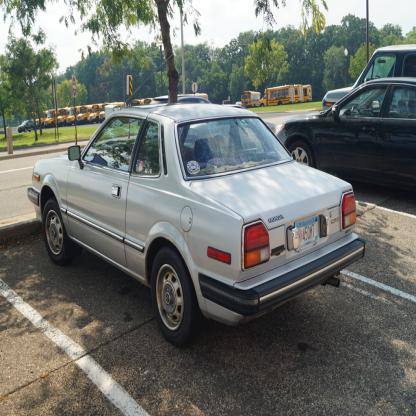

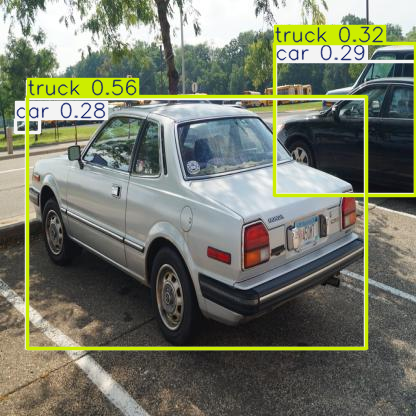


image 1/1 /content/train/images/402d1470aa6c1962_jpg.rf.6ccc3b3a1c9534e7659e16678a4cb5ca.jpg: 416x416 1 truck, 10.4ms
Speed: 1.2ms preprocess, 10.4ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 416)


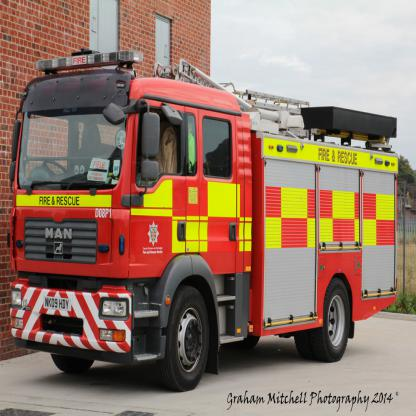

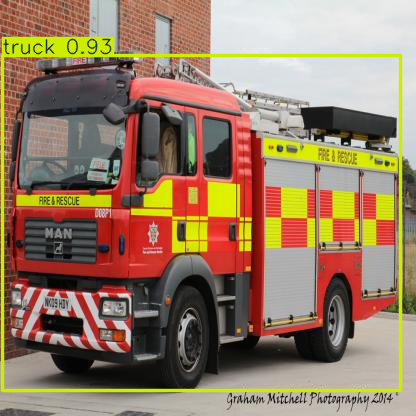


image 1/1 /content/train/images/00e13aca7d2f904a_jpg.rf.52342966f5a37167f8cfd7ea3f4dacef.jpg: 416x416 8 persons, 1 truck, 11.3ms
Speed: 1.2ms preprocess, 11.3ms inference, 8.0ms postprocess per image at shape (1, 3, 416, 416)


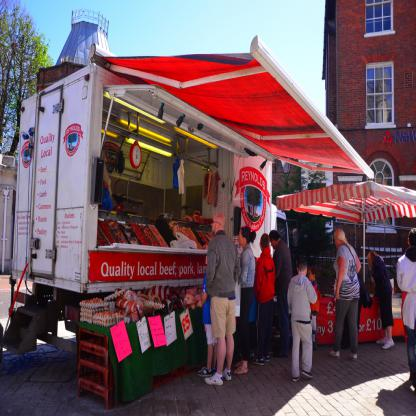

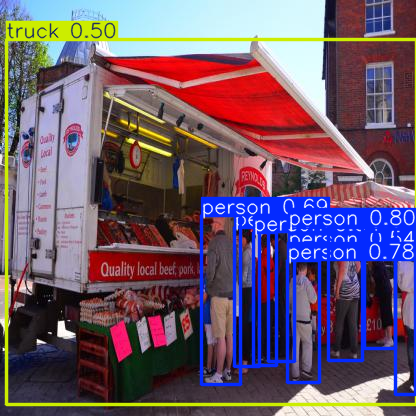


image 1/1 /content/train/images/4589c2d83ce48bae_jpg.rf.6ce68a6e77d463d5492fd8682f82ee0a.jpg: 416x416 1 truck, 12.0ms
Speed: 1.3ms preprocess, 12.0ms inference, 2.5ms postprocess per image at shape (1, 3, 416, 416)


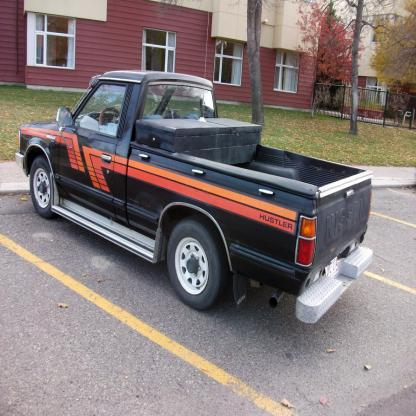

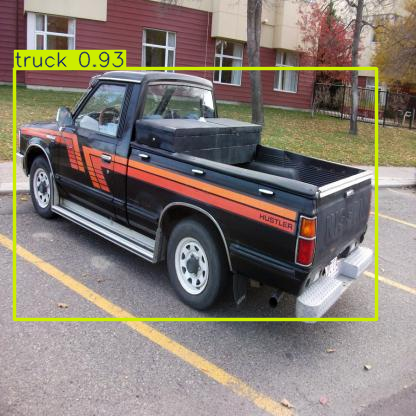


image 1/1 /content/train/images/e887c2fbb6a47737_jpg.rf.afba00e4c1732a507d0701c3f8339dcc.jpg: 416x416 5 buss, 8.2ms
Speed: 1.1ms preprocess, 8.2ms inference, 2.9ms postprocess per image at shape (1, 3, 416, 416)


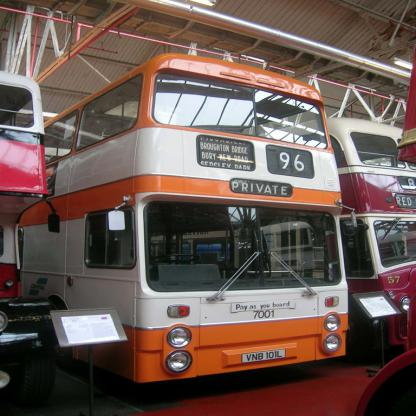

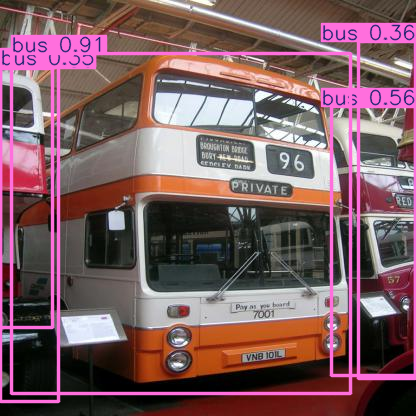


image 1/1 /content/train/images/944965d358ae7d52_jpg.rf.moZBwbNBbrpvpXpMbPam.jpg: 416x416 1 truck, 8.1ms
Speed: 1.2ms preprocess, 8.1ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 416)


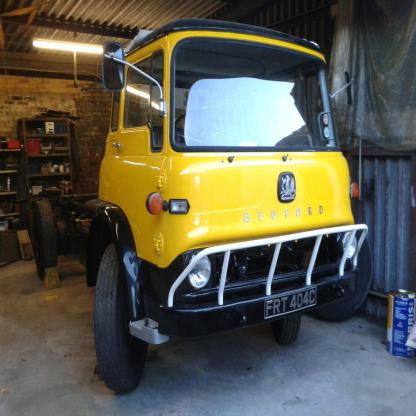

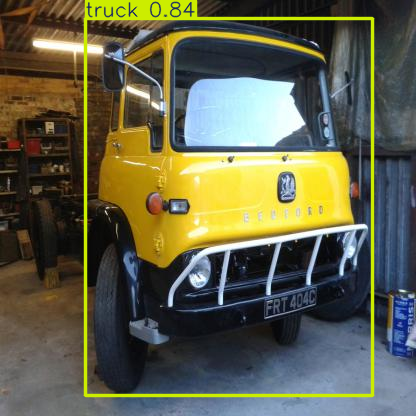


image 1/1 /content/train/images/2b9ced539656ae78_jpg.rf.09375be44a0f433daca7f5d9d5a69aa1.jpg: 416x416 3 persons, 1 truck, 1 dog, 7.9ms
Speed: 1.1ms preprocess, 7.9ms inference, 5.9ms postprocess per image at shape (1, 3, 416, 416)


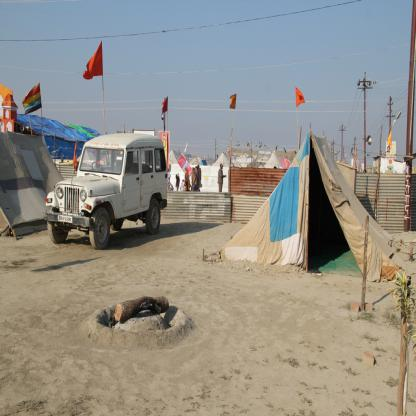

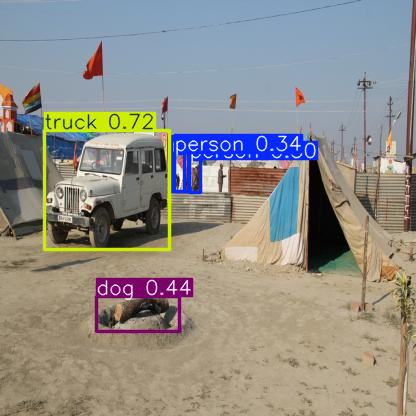

In [16]:
random_images = random.sample(image_files, 20)
model = YOLO("yolov8n.pt")
for image_file in random_images:
    image_path = os.path.join(images_folder, image_file)
    result_predict = model.predict(source=image_path, imgsz=(416))
    original_image = Image.open(image_path)
    display(original_image)
    for result in result_predict:
        plot = result.plot()
        plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
        display(Image.fromarray(plot))

In [17]:
finalmodel = YOLO('yolov8n.yaml').load('yolov8n.pt')
Result_finalmodel = finalmodel.train(data="/content/dataset.yaml",epochs=100, imgsz=416, batch=16, lr0=0.001, dropout=0.1, device=0)

Transferred 355/355 items from pretrained weights
Ultralytics 8.3.196 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.1, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=416, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.yaml, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patie

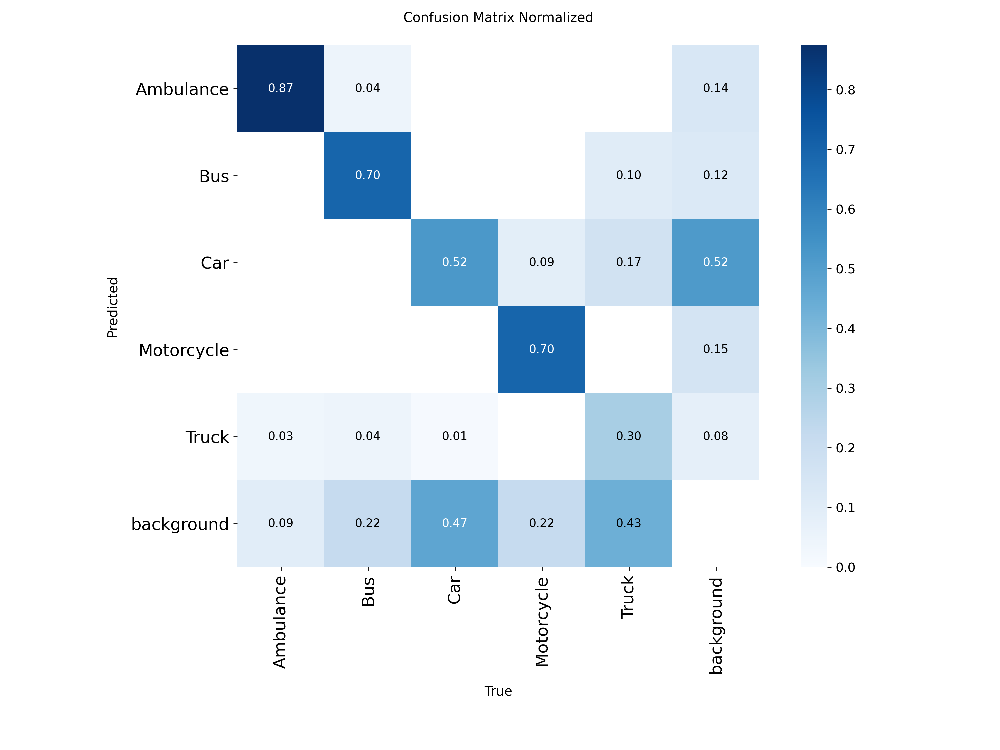

In [18]:
from IPython.display import Image, display
image_path = '/content/runs/detect/train/confusion_matrix_normalized.png'
display(Image(filename=image_path))

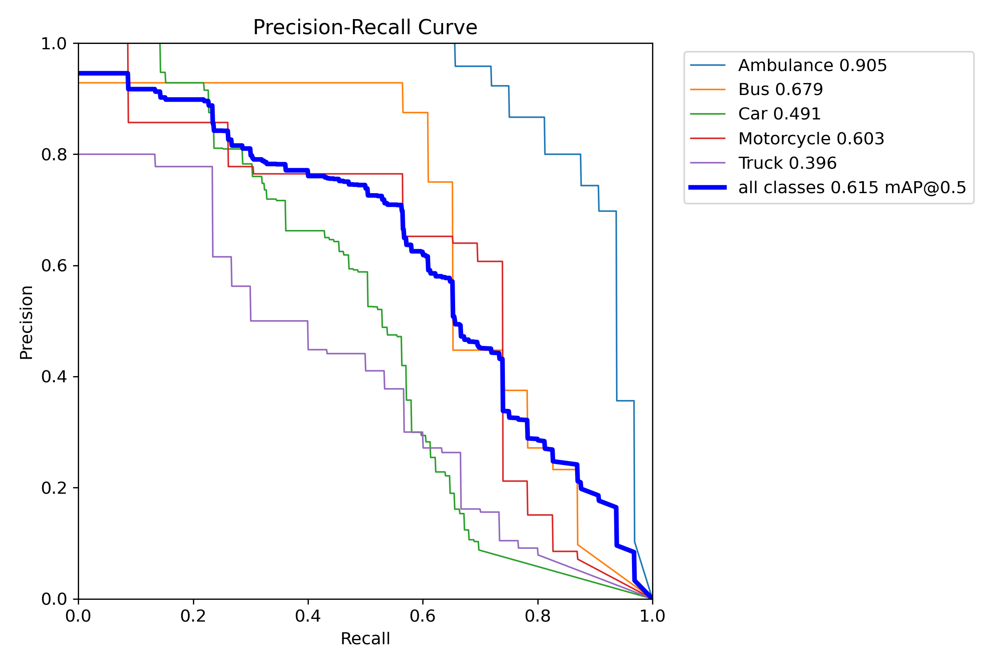

In [20]:
image_path = '/content/runs/detect/train/BoxPR_curve.png'
display(Image(filename=image_path))

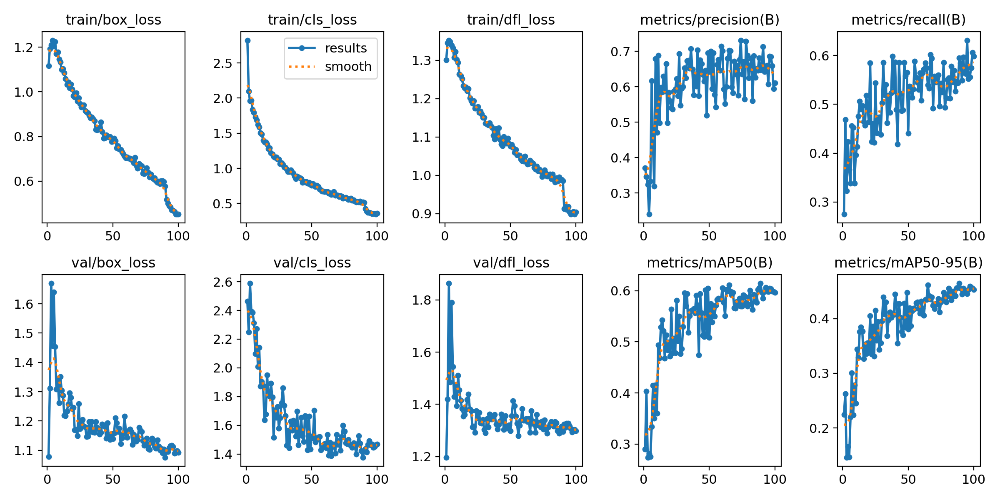

In [19]:
image_path = '/content/runs/detect/train/results.png'
display(Image(filename=image_path))

In [21]:
best_model = YOLO('/content/runs/detect/train/weights/best.pt')
metrics = best_model.val(split = 'test')

Ultralytics 8.3.196 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8n summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 670.4±192.7 MB/s, size: 26.1 KB)
val: Scanning /content/test/labels... 126 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 126/126 2.4Kit/s 0.1s
val: New cache created: /content/test/labels.cache
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 8/8 4.0it/s 2.0s
                   all        126        258      0.759      0.669      0.737      0.557
             Ambulance         18         18      0.951          1      0.995      0.919
                   Bus         22         38      0.929      0.737      0.835      0.601
                   Car         60        150      0.575       0.56      0.598      0.428
            Motorcycle         12         32       0.61        0.5      0.619      0.332
               


0: 416x416 2 Cars, 10.0ms
Speed: 1.3ms preprocess, 10.0ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 416)


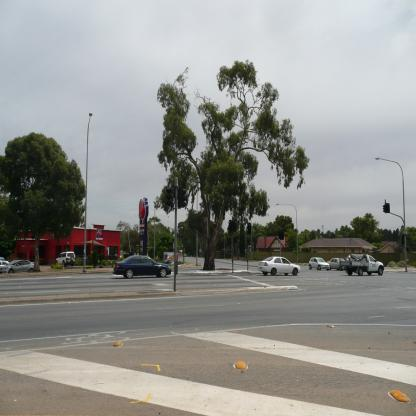

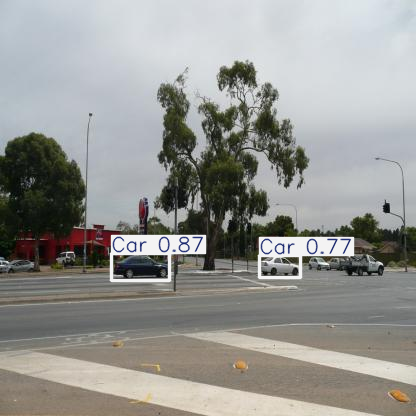


0: 416x416 1 Bus, 7.8ms
Speed: 1.2ms preprocess, 7.8ms inference, 5.7ms postprocess per image at shape (1, 3, 416, 416)


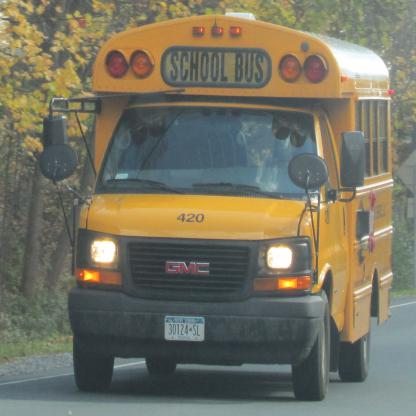

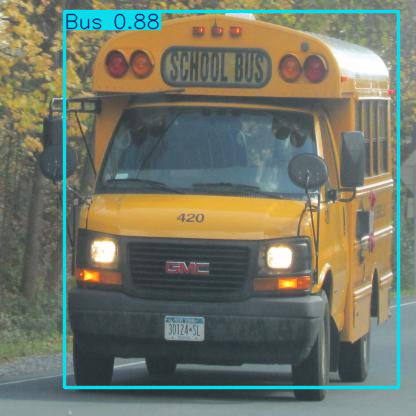


0: 416x416 2 Cars, 12.9ms
Speed: 1.0ms preprocess, 12.9ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 416)


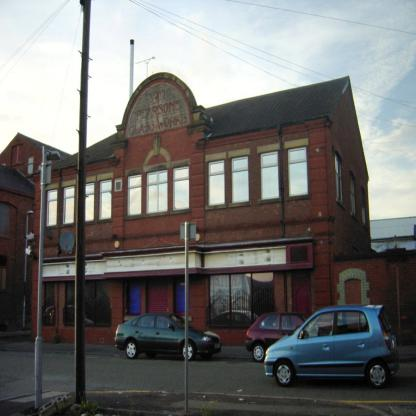

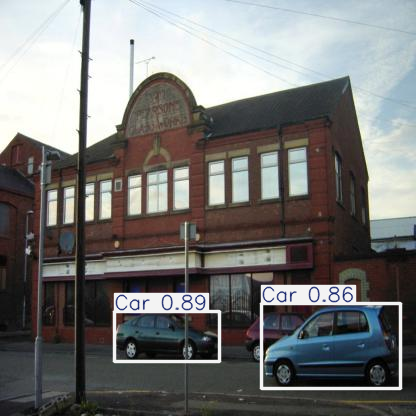


0: 416x416 1 Ambulance, 1 Motorcycle, 12.4ms
Speed: 1.1ms preprocess, 12.4ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 416)


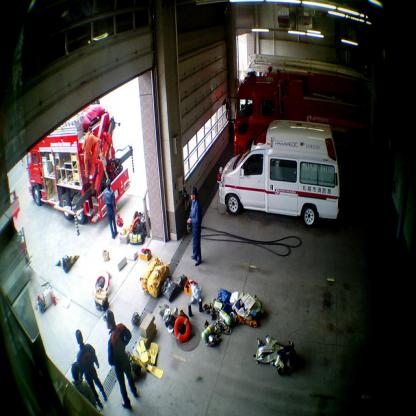

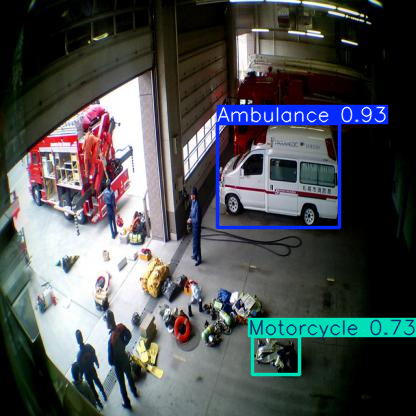


0: 416x416 1 Car, 8.3ms
Speed: 1.4ms preprocess, 8.3ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 416)


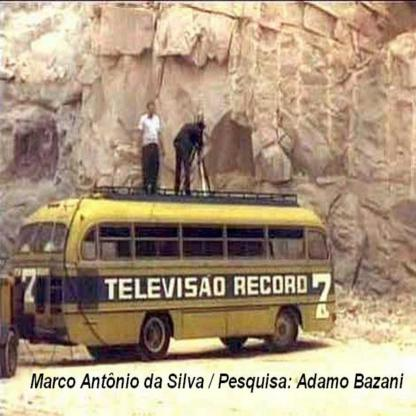

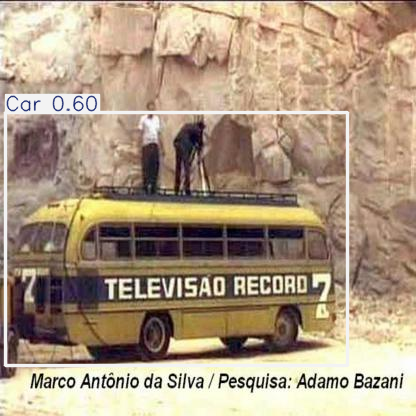


0: 416x416 (no detections), 9.4ms
Speed: 1.2ms preprocess, 9.4ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 416)


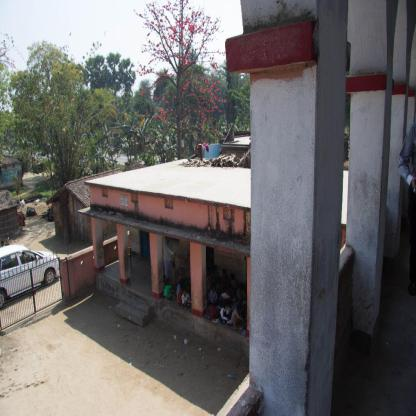

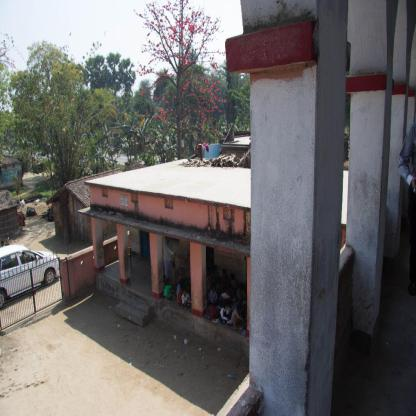


0: 416x416 1 Car, 8.0ms
Speed: 1.4ms preprocess, 8.0ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


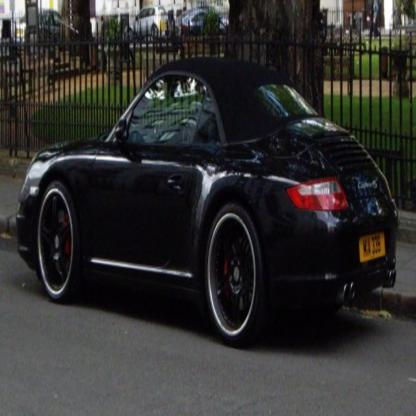

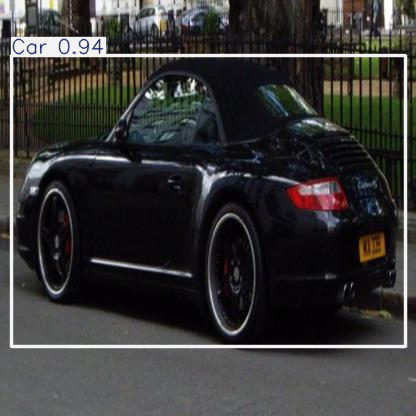


0: 416x416 1 Bus, 12.8ms
Speed: 1.1ms preprocess, 12.8ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 416)


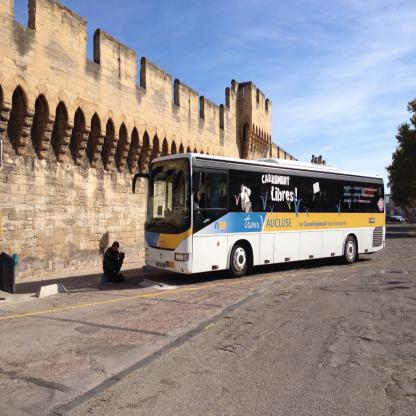

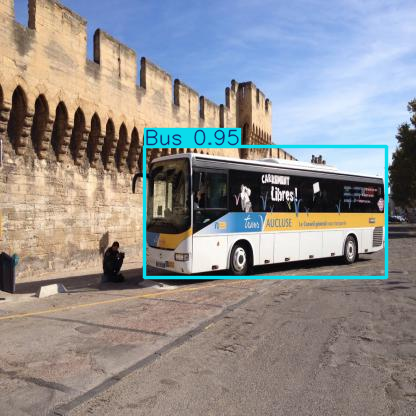


0: 416x416 2 Cars, 12.2ms
Speed: 1.2ms preprocess, 12.2ms inference, 3.1ms postprocess per image at shape (1, 3, 416, 416)


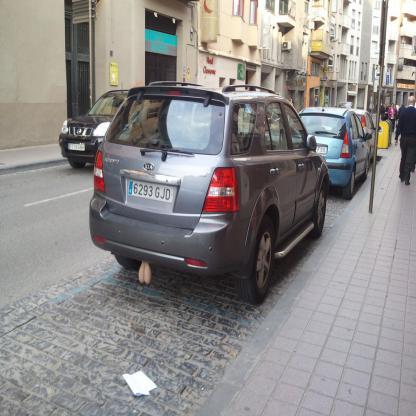

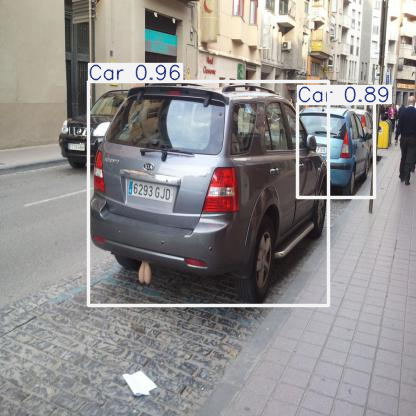


0: 416x416 1 Car, 7.9ms
Speed: 1.4ms preprocess, 7.9ms inference, 4.7ms postprocess per image at shape (1, 3, 416, 416)


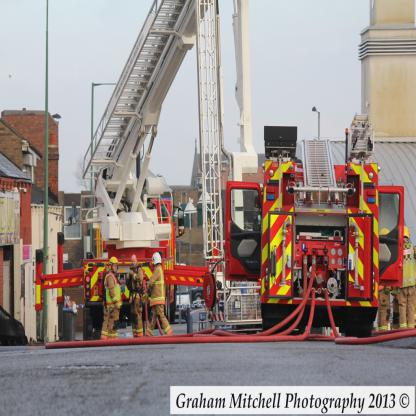

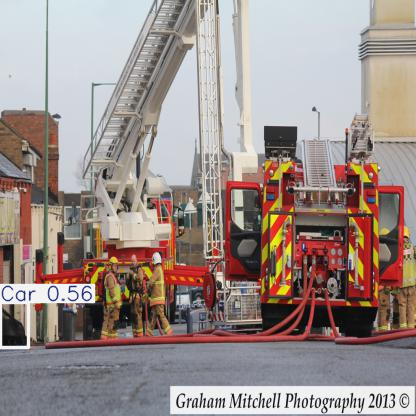

In [23]:
from PIL import Image
image_dir = '/content/test/images'
image_files = [os.path.join(image_dir, file) for file in os.listdir(image_dir) if file.endswith('.jpg')]
random_images = random.sample(image_files, k=10)
save_dir = '/working/yolo_results'
os.makedirs(save_dir, exist_ok=True)
for image_path in random_images:
    image = Image.open(image_path).convert('RGB')
    image_np = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)
    results = best_model.predict([image_np], save_dir=save_dir, imgsz=416, conf=0.5, iou=0.7)
    display(image)
    plot = results[0].plot()
    plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
    display(Image.fromarray(plot))